### ___決定木の可視化__

- 特徴量の重要度

- graphviz

- dtreeviz

### __準備・学習__

In [32]:
!pip install graphviz dtreeviz | tail -n 1

In [33]:
import pandas as pd
from sklearn.tree import DecisionTreeRegressor

In [34]:
# 学習データ・テストデータ
train = pd.read_csv("sample_data/california_housing_train.csv")
test = pd.read_csv("sample_data/california_housing_test.csv")
train.shape, test.shape

((17000, 9), (3000, 9))

In [35]:
# 説明変数・目的変数
X_train = train.drop(columns="median_house_value")
y_train = train["median_house_value"]
X_test = test.drop(columns="median_house_value")
y_test = test["median_house_value"]

In [36]:
# 学習
model = DecisionTreeRegressor(max_depth=3)
model.fit(X_train, y_train)

# 決定係数
model.score(X_train, y_train), model.score(X_test, y_test)

(0.5005506577654688, 0.4794612157988589)

### __特徴量の重要度の可視化__

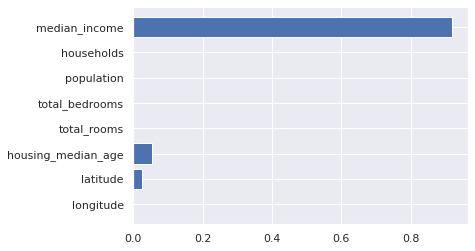

In [37]:
import matplotlib.pyplot as plt
import seaborn as sns

sns.set()

plt.barh(X_train.columns, model.feature_importances_)
plt.show()

### __graphvizによる可視化__

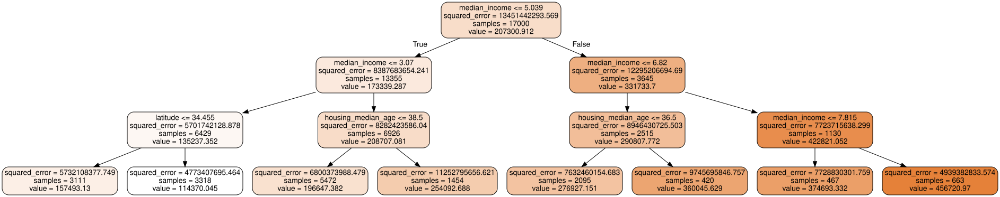

In [54]:
import graphviz
from sklearn.tree import export_graphviz

dot = export_graphviz(
    model,
    out_file=None,
    filled=True, # 色塗り
    rounded=True, # ノードの角を丸く表示
    feature_names=X_train.columns, # 説明変数
    class_names="median_house_value", # 目的変数
)

graphviz.Source(dot)

### __dtreeviz__

- [Github](https://github.com/parrt/dtreeviz)

- [公式のサンプルコード](https://colab.research.google.com/github/parrt/dtreeviz/blob/master/notebooks/dtreeviz_sklearn_visualisations.ipynb#scrollTo=ydBYDfqkeMMo)

- 決定木だけでなく、LightGBMやXBGoostなどもサポートしている

In [39]:
import dtreeviz

viz_model = dtreeviz.model(
    model,
    X_train,
    y_train,
    target_name="median_house_value", # 目的変数
    feature_names=X_train.columns, # 説明変数
)

In [40]:
# 表示
# scaleで拡大・縮小率を指定できる
viz_model.view(scale=2)

/usr/local/lib/python3.8/dist-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but DecisionTreeRegressor was fitted with feature names


In [41]:
# 横向き表示
# LR = Lift to Right
viz_model.view(orientation="LR")

In [42]:
# 簡易的に表示
viz_model.view(fancy=False)

In [53]:
# 画像の保存
# svg形式でしか保存できない

v = viz_model.view()
v.save("decision_tree.svg")

In [43]:
# データの予測値を辿る

x = X_test.loc[0]
x

longitude             -122.0500
latitude                37.3700
housing_median_age      27.0000
total_rooms           3885.0000
total_bedrooms         661.0000
population            1537.0000
households             606.0000
median_income            6.6085
Name: 0, dtype: float64

In [44]:
# 決定木全体とデータが通ったノードを合わせて表示
viz_model.view(x=x)

In [45]:
# データが通ったノードのみを表示
viz_model.view(x=x, show_just_path=True)

In [46]:
# データの分岐条件のみ出力
# 3回分岐しているが、同じ変数で2回分岐しているので分岐条件は2つに減っていることに注意
print(viz_model.explain_prediction_path(x))

housing_median_age < 36.5
5.04 <= median_income  < 6.82



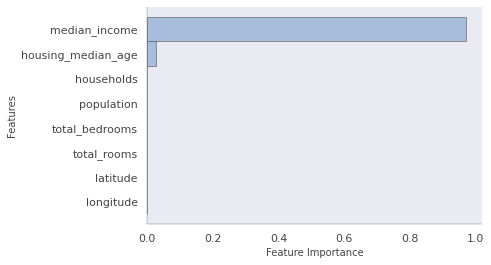

In [47]:
# 特定のデータの特徴量の重要度
viz_model.instance_feature_importance(x=x)

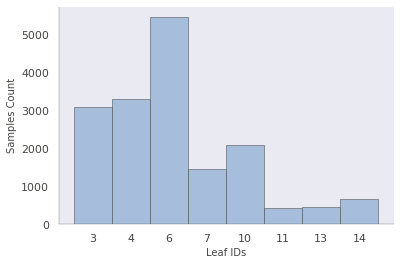

In [48]:
# 葉ノードの大きさ
viz_model.leaf_sizes()

In [49]:
# 葉ノードの情報

node_id = 3
viz_model.node_stats(node_id=node_id)

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income
count,3111.000000,3111.000000,3111.000000,3111.000000,3111.000000,3111.000000,3111.000000,3111.000000
mean,-117.815529,33.777711,30.771135,2165.139826,574.226294,1604.479589,523.765349,2.270447
std,0.736944,0.490733,11.326250,1635.187183,423.545788,1211.464355,373.445267,0.531998
min,-119.860000,32.540000,2.000000,11.000000,5.000000,3.000000,3.000000,0.499900
25%,-118.280000,33.750000,22.000000,1216.500000,314.000000,898.000000,298.000000,1.926600
50%,-118.150000,33.980000,32.000000,1809.000000,477.000000,1359.000000,444.000000,2.323600
75%,-117.250000,34.070000,39.000000,2628.500000,699.500000,2011.000000,647.000000,2.701400
max,-114.310000,34.450000,52.000000,25135.000000,4952.000000,35682.000000,4769.000000,3.069400
